# Understanding Facial Expression through people's response
---

## IDS 576 Deep Learning and Applications, Fall 2023
---

## Group 3

### Uvashiben Patel (UIN 656803288)
### Tanmay Rewari (UIN 656245314)
### Vinay Khandelwal (UIN 679706443)

## Importing Libraries

In [1]:
#pip install torchvision
import torch

In [2]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)
%cd /content/drive/MyDrive/IDS576_DeepLearning/Project
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

Mounted at /content/drive
/content/drive/MyDrive/IDS576_DeepLearning/Project


In [3]:
import numpy as np
import os
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

In [4]:
import tensorflow as tf
import keras
from keras.models import Sequential
from keras.layers import Conv2D, MaxPooling2D, AveragePooling2D
from keras.layers import Dense, Activation, Dropout, Flatten
from keras.preprocessing import image
from keras.preprocessing.image import ImageDataGenerator
import pandas as pd
import numpy as np
import matplotlib.pyplot as pltv
import cv2
import matplotlib.pyplot as plt

### Uploading the dataset

In [5]:
fer13 = 'Datasets/fer2013.csv'
map_emotion = ['Anger', 'Disgust', 'Fear', 'Happy', 'Sad', 'Surprise', 'Neutral']
columns=['emotion','pixels','usage']
dFrame=pd.read_csv('Datasets/fer2013.csv',names=columns, na_filter=False)
image=dFrame['pixels']
dFrame.head(10)

,emotion,pixels,usage
0,emotion,pixels,Usage
1,0,70 80 82 72 58 58 60 63 54 58 60 48 89 115 121...,Training
2,0,151 150 147 155 148 133 111 140 170 174 182 15...,Training
3,2,231 212 156 164 174 138 161 173 182 200 106 38...,Training
4,4,24 32 36 30 32 23 19 20 30 41 21 22 32 34 21 1...,Training
5,6,4 0 0 0 0 0 0 0 0 0 0 0 3 15 23 28 48 50 58 84...,Training
6,2,55 55 55 55 55 54 60 68 54 85 151 163 170 179 ...,Training
7,4,20 17 19 21 25 38 42 42 46 54 56 62 63 66 82 1...,Training
8,3,77 78 79 79 78 75 60 55 47 48 58 73 77 79 57 5...,Training
9,3,85 84 90 121 101 102 133 153 153 169 177 189 1...,Training


In [6]:
dFrame_1 = pd.read_csv('Datasets/fer2013.csv')
#check data shape
dFrame_1.shape
dFrame_1.Usage.value_counts()

Training       28709
PublicTest      3589
PrivateTest     3589
Name: Usage, dtype: int64

In [7]:
#check target labels
target_mapping = {0: 'Angry', 1: 'Digust', 2: 'Fear', 3: 'Happy', 4: 'Sad', 5: 'Surprise', 6: 'Neutral'}
label_counts = dFrame_1['emotion'].value_counts(sort=False).reset_index()
label_counts.columns = ['emotion', 'number']
label_counts['emotion'] = label_counts['emotion'].map(target_mapping)
label_counts

,emotion,number
0,Angry,4953
1,Fear,5121
2,Sad,6077
3,Neutral,6198
4,Happy,8989
5,Surprise,4002
6,Digust,547


### Plotting the Bar Graph for Number of Images for Each Emotion

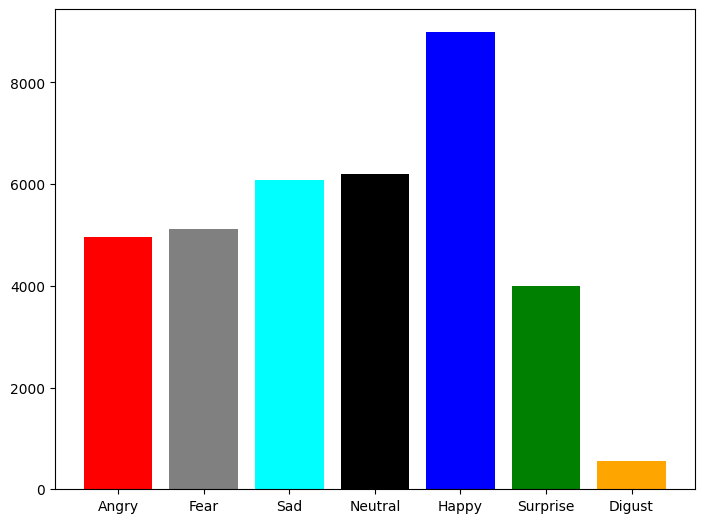

In [8]:
import matplotlib.pyplot as plt
figure = plt.figure()
axis = figure.add_axes([0,0,1,1])
emotion = label_counts['emotion']
total_num = label_counts['number']

# Create bars with different colors
plt.bar(emotion, total_num, color=['red', 'grey', 'cyan' , 'black', 'blue', 'green', 'orange'])


# Show graph
plt.show()

### Plotting some images from the dataset

<ipython-input-9-d7b4c6874abf>:11: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  return np.array([imag.astype(np.uint8), emtn])


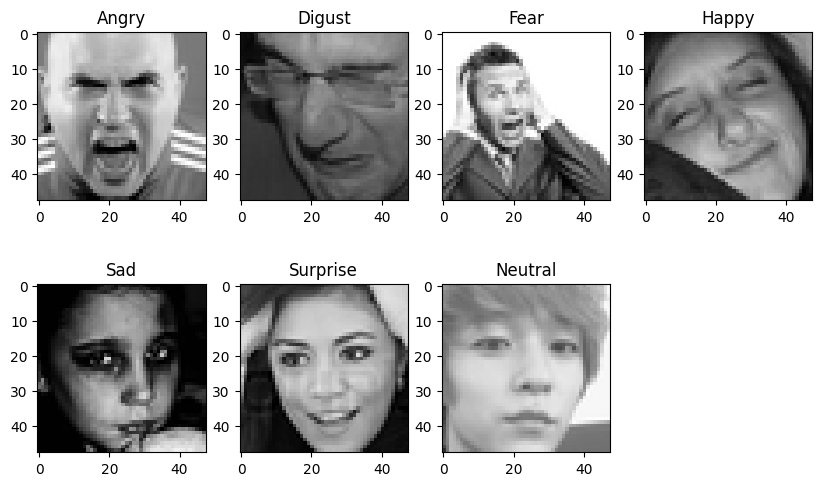

In [9]:
#Let's look at some images...

def row2image(row):
    pxl, emtn = row['pixels'], target_mapping[row['emotion']]
    _img_ = np.array(pxl.split())
    _img_ = _img_.reshape(48,48)
    imag = np.zeros((48,48,3))
    imag[:,:,0] = _img_
    imag[:,:,1] = _img_
    imag[:,:,2] = _img_
    return np.array([imag.astype(np.uint8), emtn])

plt.figure(0, figsize=(10,6))
for i in range(1,8):
    faces = dFrame_1[dFrame_1['emotion'] == i-1].iloc[3]
    _img_ = row2image(faces)
    plt.subplot(2,4,i)
    plt.imshow(_img_[0])
    plt.title(_img_[1])

plt.show()

In [10]:
def getData(fer13):
    # images are 48x48
    # X = 35887
    N = []
    M = []
    first = True
    for line in open(fer13):
        if first:
            first = False
        else:
            row = line.split(',')
            N.append(int(row[0]))
            M.append([int(p) for p in row[1].split()])

    M, N = np.array(M) / 255.0, np.array(N)
    return M, N

In [11]:
M, N = getData(fer13)
num_class = len(set(N))
print(num_class)

7


In [12]:
X, D = M.shape
M = M.reshape(X, 48, 48, 1)

---
## Facial Feature Extraction Using Haar Cascade Method
---

### Eyes and Face Annotation For An Individual Picture

In [13]:
def annotate(_img_):
    face_Cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')
    eye_Cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_eye.xml')
    gray_color = cv2.cvtColor(_img_, cv2.COLOR_BGR2GRAY)
    image_face = face_Cascade.detectMultiScale(gray_color, 1.3, 5)
    print('Number of faces detected:', len(image_face))
    for (x, y, w, h) in image_face:
        cv2.rectangle(_img_, (x,y) , (x+w, y+h) , (0,255,0) , 4)
    eyes_image = eye_Cascade.detectMultiScale(gray_color, 1.3, 5)
    print('Number of eyes detected:', len(eyes_image))
    for (ex,ey,ew,eh) in eyes_image:
        cv2.rectangle(_img_,(ex,ey),(ex+ew,ey+eh),(0,255,0),4)

    plt.imshow(cv2.cvtColor(_img_, cv2.COLOR_BGR2RGB))

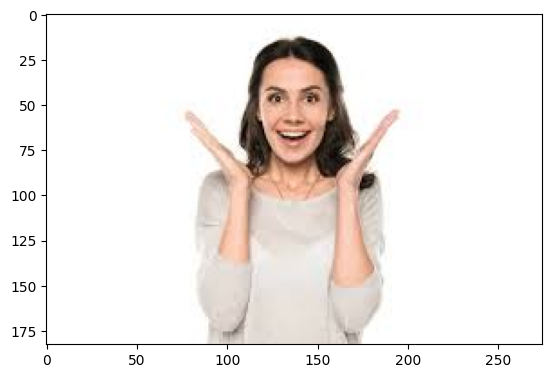

In [14]:
_img__happy=cv2.imread("Images/happy_image.jpeg")
plt.imshow(cv2.cvtColor(_img__happy, cv2.COLOR_BGR2RGB))

Number of faces detected: 1
Number of eyes detected: 0


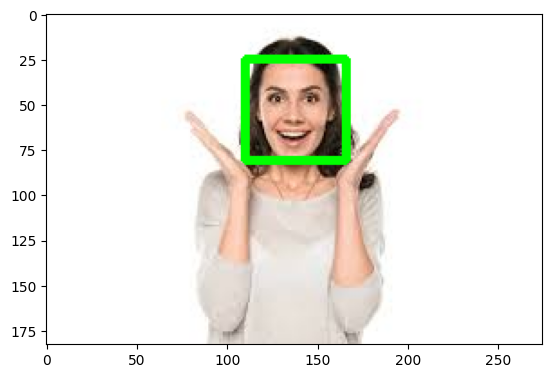

In [15]:
annotate(_img__happy)

### Eyes and Face Annotation For Group Pictures

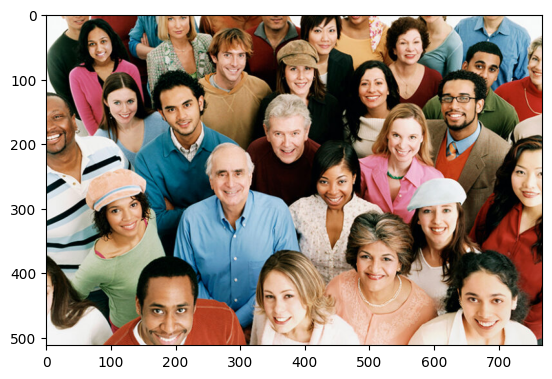

In [16]:
_img_=cv2.imread("Images/team.jpeg")
plt.imshow(cv2.cvtColor(_img_, cv2.COLOR_BGR2RGB))

Number of faces detected: 18
Number of eyes detected: 15


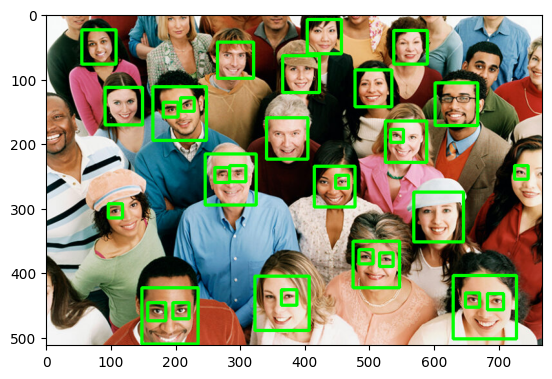

In [17]:
annotate(_img_)

### Facial and Eyes Annotation For Images in Our Dataset

In [18]:
def annotate_1(_img_):
    face_Cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')
    eye_Cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_eye.xml')
    gray_color = cv2.cvtColor(_img_, cv2.COLOR_BGR2GRAY)
    image_face = face_Cascade.detectMultiScale(gray_color, 1.3, 5)
    for (x, y, w, h) in image_face:
        cv2.rectangle(_img_, (x,y) , (x+w, y+h) , (0,255,0) , 4)
    eyes_image = eye_Cascade.detectMultiScale(gray_color, 1.3, 5)
    for (ex,ey,ew,eh) in eyes_image:
        cv2.rectangle(_img_,(ex,ey),(ex+ew,ey+eh),(0,255,0),4)

    plt.imshow(cv2.cvtColor(_img_, cv2.COLOR_BGR2RGB))

<ipython-input-19-eb95e18054de>:11: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  return np.array([imag.astype(np.uint8), emtn])


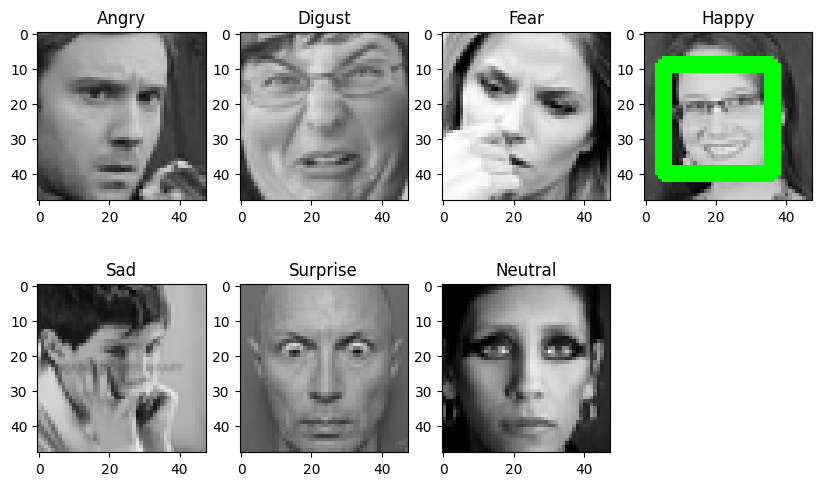

In [19]:
#Let's look at some images...

def row2image(row):
    pxl, emtn = row['pixels'], target_mapping[row['emotion']]
    _img_ = np.array(pxl.split())
    _img_ = _img_.reshape(48,48)
    imag = np.zeros((48,48,3))
    imag[:,:,0] = _img_
    imag[:,:,1] = _img_
    imag[:,:,2] = _img_
    return np.array([imag.astype(np.uint8), emtn])

plt.figure(0, figsize=(10,6))
for i in range(1,8):
    faces = dFrame_1[dFrame_1['emotion'] == i-1].iloc[0]
    _img_ = row2image(faces)
    plt.subplot(2,4,i)
    annotate_1(_img_[0])
    plt.imshow(cv2.cvtColor(_img_[0], cv2.COLOR_BGR2RGB))
    plt.title(_img_[1])

plt.show()

---
## Creating the CNN Model and Predicting the Emotions
---

### Train-Test Split

In [20]:
from sklearn.model_selection import train_test_split

m_train, m_test, n_train, n_test = train_test_split(M, N, test_size=0.1, random_state=0)
n_train = (np.arange(num_class) == n_train[:, None]).astype(np.float32)
n_test = (np.arange(num_class) == n_test[:, None]).astype(np.float32)

In [21]:
from keras.models import Sequential
from keras.layers import Dense , Activation , Dropout ,Flatten, Conv2D, MaxPooling2D
from keras.metrics import categorical_accuracy
from keras.models import model_from_json
from keras.callbacks import ModelCheckpoint
from keras.optimizers import *
from tensorflow.keras.layers import BatchNormalization

In [22]:
def cnn_model():
    mdl = Sequential()
    input_shape = (48,48,1)
    mdl.add(Conv2D(64, (5, 5), input_shape=input_shape,activation='relu', padding='same'))
    mdl.add(Conv2D(64, (5, 5), activation='relu', padding='same'))
    mdl.add(BatchNormalization())
    mdl.add(MaxPooling2D(pool_size=(2, 2)))

    mdl.add(Conv2D(128, (5, 5),activation='relu',padding='same'))
    mdl.add(Conv2D(128, (5, 5),activation='relu',padding='same'))
    mdl.add(BatchNormalization())
    mdl.add(MaxPooling2D(pool_size=(2, 2)))

    mdl.add(Conv2D(256, (3, 3),activation='relu',padding='same'))
    mdl.add(Conv2D(256, (3, 3),activation='relu',padding='same'))
    mdl.add(BatchNormalization())
    mdl.add(MaxPooling2D(pool_size=(2, 2)))

    mdl.add(Flatten())
    mdl.add(Dense(128))
    mdl.add(BatchNormalization())
    mdl.add(Activation('relu'))
    mdl.add(Dropout(0.2))
    mdl.add(Dense(7))
    mdl.add(Activation('softmax'))

    mdl.compile(loss='categorical_crossentropy', metrics=['accuracy'],optimizer='adam')
    # UNCOMMENT THIS TO VIEW THE ARCHITECTURE
    #model.summary()

    return mdl
mdl=cnn_model()
mdl.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 48, 48, 64)        1664      
                                                                 
 conv2d_1 (Conv2D)           (None, 48, 48, 64)        102464    
                                                                 
 batch_normalization (Batch  (None, 48, 48, 64)        256       
 Normalization)                                                  
                                                                 
 max_pooling2d (MaxPooling2  (None, 24, 24, 64)        0         
 D)                                                              
                                                                 
 conv2d_2 (Conv2D)           (None, 24, 24, 128)       204928    
                                                                 
 conv2d_3 (Conv2D)           (None, 24, 24, 128)       4

In [23]:
from keras import backend as K
import random
mdl_path='Datasets/model_filter.h5'
tf.compat.v1.keras.backend.clear_session()
mdl=cnn_model() # create the model
K.set_value(mdl.optimizer.lr,1e-3)
# fit the model
random.seed(10)
h=mdl.fit(x=m_train,
            y=n_train,
            batch_size=64,
            epochs=10,
            verbose=1,
            validation_data=(m_test,n_test),
            shuffle=True,
            callbacks=[
                ModelCheckpoint(filepath=mdl_path),
            ]
            )

Epoch 1/10
505/505 [==============================] - 37s 39ms/step - loss: 1.7136 - accuracy: 0.3338 - val_loss: 1.9650 - val_accuracy: 0.2583
Epoch 2/10


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


505/505 [==============================] - 19s 37ms/step - loss: 1.3242 - accuracy: 0.4934 - val_loss: 1.3070 - val_accuracy: 0.4781
Epoch 3/10
505/505 [==============================] - 19s 37ms/step - loss: 1.1398 - accuracy: 0.5713 - val_loss: 1.2507 - val_accuracy: 0.5327
Epoch 4/10
505/505 [==============================] - 19s 38ms/step - loss: 1.0249 - accuracy: 0.6190 - val_loss: 1.2738 - val_accuracy: 0.5341
Epoch 5/10
505/505 [==============================] - 19s 38ms/step - loss: 0.9006 - accuracy: 0.6636 - val_loss: 1.0993 - val_accuracy: 0.5879
Epoch 6/10
505/505 [==============================] - 20s 39ms/step - loss: 0.7743 - accuracy: 0.7143 - val_loss: 1.1885 - val_accuracy: 0.5860
Epoch 7/10
505/505 [==============================] - 20s 39ms/step - loss: 0.6299 - accuracy: 0.7690 - val_loss: 1.3211 - val_accuracy: 0.5559
Epoch 8/10
505/505 [==============================] - 19s 38ms/step - loss: 0.4648 - accuracy: 0.8340 - val_loss: 1.2354 - val_accuracy: 0.6105
Epo

In [24]:
objct = ('angry', 'disgust', 'fear', 'happy', 'sad', 'surprise', 'neutral')
n_pos = np.arange(len(objct))

def analyze_emotion(emotions):
    objects = ['angry', 'disgust', 'fear', 'happy', 'sad', 'surprise', 'neutral']
    n_pos = np.arange(len(objects))
    plt.bar(n_pos, emotions, align='center', alpha=0.9)
    plt.tick_params(axis='x', which='both', pad=10,width=4,length=10)
    plt.xticks(n_pos, objects)
    plt.ylabel('percentage')
    plt.title('emotion')

plt.show()

In [25]:
from keras.models import load_model
mdl =load_model(r'Datasets/model_filter.h5')

n_pred=mdl.predict(m_test)
#print(y_pred)
n_test.shape

113/113 [==============================] - 1s 6ms/step


(3589, 7)

### Predicting the Emotions from an Individual Image Uploaded Externally

/usr/local/lib/python3.10/dist-packages/keras/src/utils/image_utils.py:409: UserWarning: grayscale is deprecated. Please use color_mode = "grayscale"
  warnings.warn(


1/1 [==============================] - 0s 154ms/step


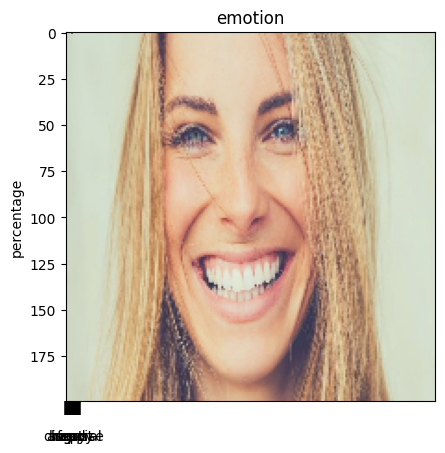

Expression Prediction: happy


In [26]:
from skimage import io
import numpy as np
from tensorflow.keras.utils import load_img, img_to_array
_img_ = load_img('Images/happy_4.jpg', grayscale=True, target_size=(48, 48))
show_img=load_img('Images/happy_4.jpg', grayscale=False, target_size=(200, 200))
m = img_to_array(_img_)
m = np.expand_dims(m, axis = 0)

m /= 255

custom = mdl.predict(m)
#print(custom[0])
analyze_emotion(custom[0])

m = np.array(m, 'float32')
m = m.reshape([48, 48]);

plt.gray()
plt.imshow(show_img)
plt.show()

decimal=0.000000000000000001
a=custom[0]
for i in range(0,len(a)):
    if a[i]>decimal:
        decimal=a[i]
        ind=i

print('Expression Prediction:',objct[ind])

1/1 [==============================] - 0s 21ms/step


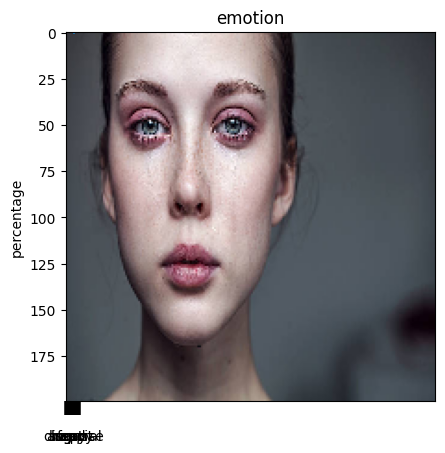

Expression Prediction: sad


In [27]:
from skimage import io
_img_ = load_img('Images/sad.jpeg', grayscale=True, target_size=(48, 48))
show_img=load_img('Images/sad.jpeg', grayscale=False, target_size=(200, 200))
m = img_to_array(_img_)
m = np.expand_dims(m, axis = 0)

m /= 255

custom = mdl.predict(m)
analyze_emotion(custom[0])

m = np.array(m, 'float32')
m = m.reshape([48, 48]);

plt.gray()
plt.imshow(show_img)
plt.show()

decimal=0.000000000000000001
a=custom[0]
for i in range(0,len(a)):
    if a[i]>decimal:
        decimal=a[i]
        ind=i

print('Expression Prediction:',objct[ind])


1/1 [==============================] - 0s 18ms/step


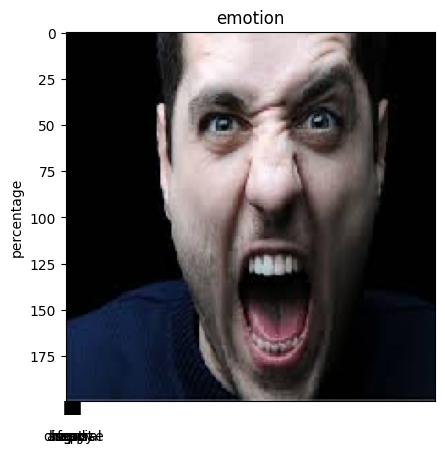

Expression Prediction: angry


In [28]:
from skimage import io
_img_ = load_img('Images/angry_2.jpeg', grayscale=True, target_size=(48, 48))
show_img=load_img('Images/angry_2.jpeg', grayscale=False, target_size=(200, 200))
m = img_to_array(_img_)
m = np.expand_dims(m, axis = 0)

m /= 255

custom = mdl.predict(m)
analyze_emotion(custom[0])

m = np.array(m, 'float32')
m = m.reshape([48, 48]);

plt.gray()
plt.imshow(show_img)
plt.show()

decimal=0.000000000000000001
a=custom[0]
for i in range(0,len(a)):
    if a[i]>decimal:
        decimal=a[i]
        ind=i

print('Expression Prediction:',objct[ind])


### Predicting the Emotions from Group Image Uploaded Externally

1/1 [==============================] - 0s 33ms/step


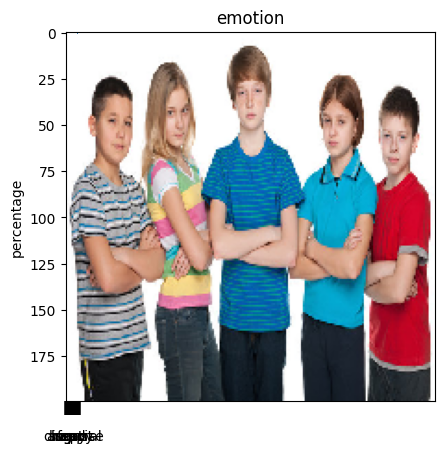

Expression Prediction: neutral


In [63]:
from skimage import io
_img_ = load_img('Images/sad_1.jpg', grayscale=True, target_size=(48, 48))
show_img=load_img('Images/sad_1.jpg', grayscale=False, target_size=(200, 200))
m = img_to_array(_img_)
m = np.expand_dims(m, axis = 0)

m /= 255

custom = mdl.predict(m)
#print(custom[0])
analyze_emotion(custom[0])

m = np.array(m, 'float32')
m = m.reshape([48, 48]);

plt.gray()
plt.imshow(show_img)
plt.show()

decimal=0.000000000000000001
a=custom[0]
for i in range(0,len(a)):
    if a[i]>decimal:
        decimal=a[i]
        ind=i

print('Expression Prediction:',objct[ind])


1/1 [==============================] - 0s 19ms/step


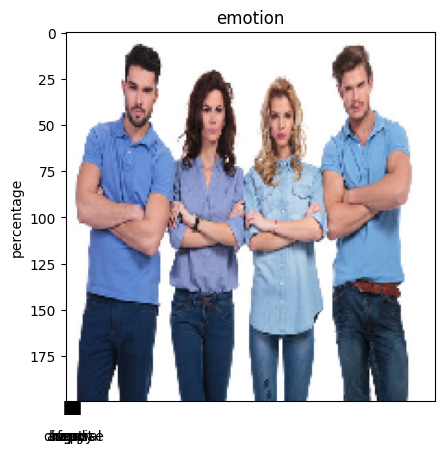

Expression Prediction: angry


In [30]:
from skimage import io
_img_ = load_img('Images/angry_image_2.jpg', grayscale=True, target_size=(48, 48))
show_img=load_img('Images/angry_image_2.jpg', grayscale=False, target_size=(200, 200))
m = img_to_array(_img_)
m = np.expand_dims(m, axis = 0)

m /= 255

custom = mdl.predict(m)
#print(custom[0])
analyze_emotion(custom[0])

m = np.array(m, 'float32')
m = m.reshape([48, 48]);

plt.gray()
plt.imshow(show_img)
plt.show()

decimal=0.000000000000000001
a=custom[0]
for i in range(0,len(a)):
    if a[i]>decimal:
        decimal=a[i]
        ind=i

print('Expression Prediction:',objct[ind])

### Finding the Accuracy For CNN Model

In [31]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report, confusion_matrix
testing_true = np.argmax(n_test, axis=1)
testing_pred = np.argmax(n_pred, axis=1)
print("CNN Model Accuracy on test set: {:.4f}".format(accuracy_score(testing_true, testing_pred)))

CNN Model Accuracy on test set: 0.6043


### Plotting the Confusion Matrix For CNN Model

In [32]:
def plot_confusion_matrix(y_true, y_pred, classes,
                          normalize=False,
                          title=None,
                          cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    if not title:
        if normalize:
            title = 'Normalized confusion matrix'
        else:
            title = 'Confusion matrix, without normalization'

    # Compute confusion matrix
    cm = confusion_matrix(y_true, y_pred)
    # Only use the labels that appear in the data
    classes = classes
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

    fig, ax = plt.subplots(figsize=(12,6))
    im = ax.imshow(cm, interpolation='nearest', cmap=cmap)
    ax.figure.colorbar(im, ax=ax)
    # We want to show all ticks...
    ax.set(xticks=np.arange(cm.shape[1]),
           yticks=np.arange(cm.shape[0]),
           # ... and label them with the respective list entries
           xticklabels=classes, yticklabels=classes,
           title=title,
           ylabel='True label',
           xlabel='Predicted label')

    # Rotate the tick labels and set their alignment.
    plt.setp(ax.get_xticklabels(), rotation=45, ha="right",
             rotation_mode="anchor")

    # Loop over data dimensions and create text annotations.
    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i in range(cm.shape[0]):
        for j in range(cm.shape[1]):
            ax.text(j, i, format(cm[i, j], fmt),
                    ha="center", va="center",
                    color="white" if cm[i, j] > thresh else "black")
    fig.tight_layout()
    return ax

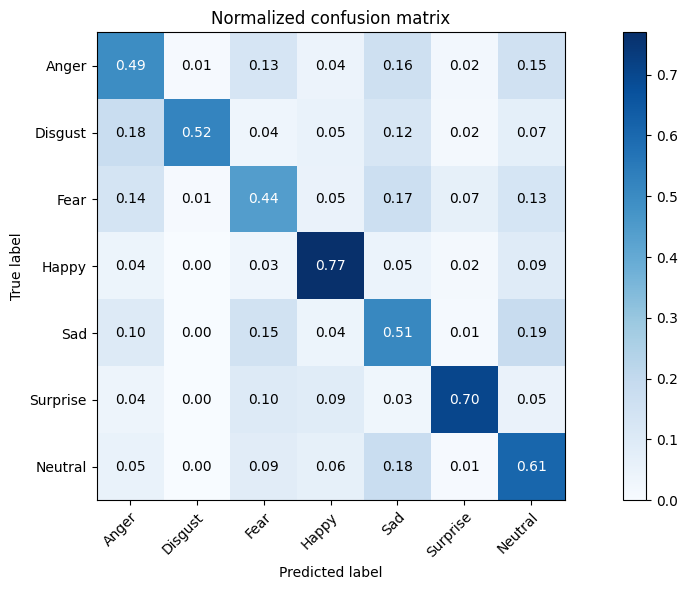

In [33]:
# Plot normalized confusion matrix
plot_confusion_matrix(testing_true, testing_pred, classes=map_emotion, normalize=True, title='Normalized confusion matrix')
plt.show()

---
## Creating the Deepface Model and Predicting the Emotions
---

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.6/49.6 kB 2.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 MB 18.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 88.3/88.3 kB 13.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 80.2/80.2 kB 12.1 MB/s eta 0:00:00
  Created wheel for fire: filename=fire-0.5.0-py2.py3-none-any.whl size=116933 sha256=da4d23553d5b04b00d13bb5530cbb849f6a69570afdd4b69f75e99b0f70d5c80
  Stored in directory: /root/.cache/pip/wheels/90/d4/f7/9404e5db0116bd4d43e5666eaa3e70ab53723e1e3ea40c9a95
Successfully built fire
Directory  /root /.deepface created
Directory  /root /.deepface/weights created


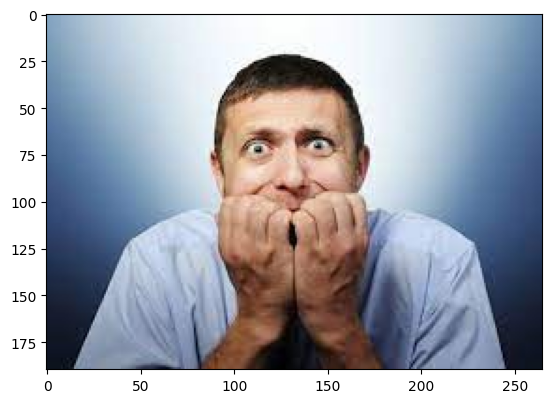

In [34]:
!pip install deepface
import cv2
from deepface import DeepFace
import matplotlib.pyplot as plt

image_deep=cv2.imread("Images/fear_image.jpeg")
plt.imshow(cv2.cvtColor(image_deep,cv2.COLOR_BGR2RGB))

\### Predicting the Emotions for An Individual Picture

In [35]:
predicted=DeepFace.analyze(image_deep)

facial_expression_model_weights.h5 will be downloaded...


Downloading...
From: https://github.com/serengil/deepface_models/releases/download/v1.0/facial_expression_model_weights.h5
To: /root/.deepface/weights/facial_expression_model_weights.h5
100%|██████████| 5.98M/5.98M [00:00<00:00, 28.0MB/s]


age_model_weights.h5 will be downloaded...


Downloading...
From: https://github.com/serengil/deepface_models/releases/download/v1.0/age_model_weights.h5
To: /root/.deepface/weights/age_model_weights.h5
100%|██████████| 539M/539M [00:02<00:00, 242MB/s]


gender_model_weights.h5 will be downloaded...


Downloading...
From: https://github.com/serengil/deepface_models/releases/download/v1.0/gender_model_weights.h5
To: /root/.deepface/weights/gender_model_weights.h5
100%|██████████| 537M/537M [00:04<00:00, 128MB/s]


race_model_single_batch.h5 will be downloaded...


Downloading...
From: https://github.com/serengil/deepface_models/releases/download/v1.0/race_model_single_batch.h5
To: /root/.deepface/weights/race_model_single_batch.h5
100%|██████████| 537M/537M [00:02<00:00, 231MB/s]
Action: race: 100%|██████████| 4/4 [00:03<00:00,  1.27it/s]


In [36]:
predicted

[{'emotion': {'angry': 2.7999237931728027e-08,
   'disgust': 5.2976387287820986e-11,
   'fear': 99.79926942582544,
   'happy': 1.3905033509643341e-08,
   'sad': 4.1551280450543997e-07,
   'surprise': 0.20073204100770003,
   'neutral': 4.996838310639922e-10},
  'dominant_emotion': 'fear',
  'region': {'x': 85, 'y': 35, 'w': 88, 'h': 88},
  'age': 33,
  'gender': {'Woman': 0.01744396722642705, 'Man': 99.98255372047424},
  'dominant_gender': 'Man',
  'race': {'asian': 0.7970864903433907,
   'indian': 4.68179490349232,
   'black': 0.35128199492031276,
   'white': 34.16132738129227,
   'middle eastern': 36.95717596497249,
   'latino hispanic': 23.051337665478904},
  'dominant_race': 'middle eastern'}]

In [37]:

predicted[0]['dominant_emotion']

'fear'

In [38]:
predicted[0]['age']

33

In [39]:
predicted[0]['dominant_race']

'middle eastern'

In [40]:
predicted[0]['gender']

{'Woman': 0.01744396722642705, 'Man': 99.98255372047424}

Number of faces detected: 1
Number of eyes detected: 2


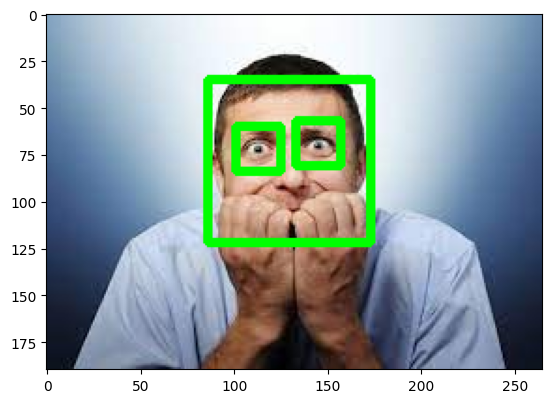

In [41]:
annotate(image_deep)

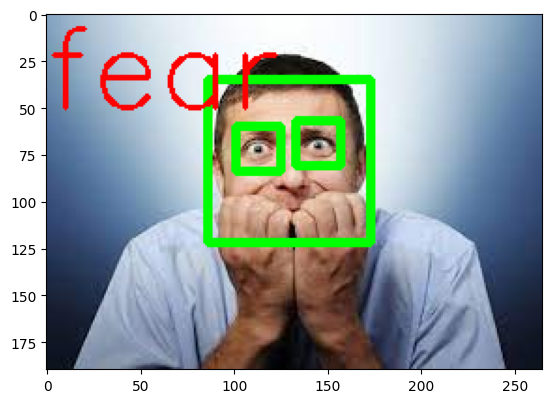

In [42]:
font = cv2.FONT_HERSHEY_SIMPLEX

cv2.putText(image_deep,
            predicted[0]['dominant_emotion'],
            (0,50),
            font, 2,
            (0,0,255),
            2,);
plt.imshow(cv2.cvtColor(image_deep, cv2.COLOR_BGR2RGB))

### Predicting the Emotions for A Group Picture

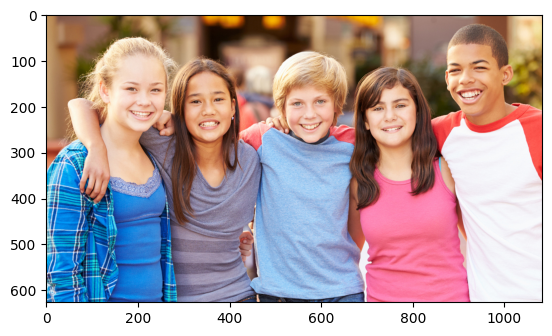

In [43]:
image_deep_grp=cv2.imread("Images/youngerteens.jpg")
plt.imshow(cv2.cvtColor(image_deep_grp,cv2.COLOR_BGR2RGB))

In [44]:
predicted=DeepFace.analyze(image_deep_grp)

Action: race: 100%|██████████| 4/4 [00:00<00:00,  4.63it/s]


In [45]:
predicted[0]['dominant_emotion']

'happy'

Number of faces detected: 5
Number of eyes detected: 10


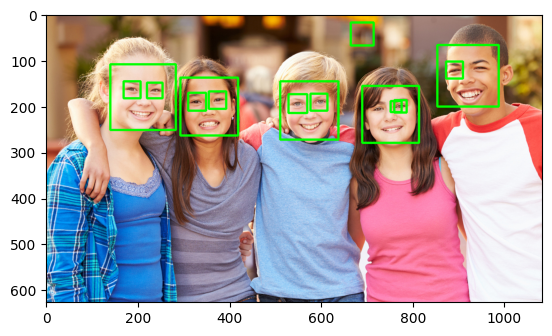

In [46]:
annotate(image_deep_grp)

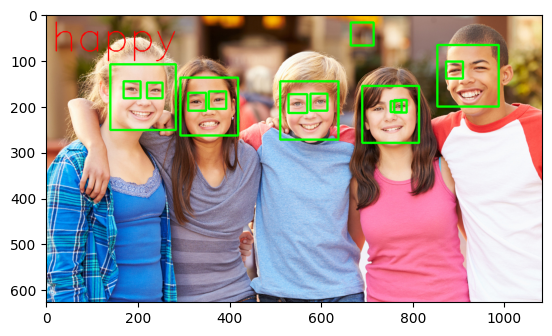

In [47]:
font = cv2.FONT_HERSHEY_SIMPLEX

cv2.putText(image_deep_grp,
            predicted[0]['dominant_emotion'],
            (10,80),
            font, 3,
            (0,0,255),
            2,);
plt.imshow(cv2.cvtColor(image_deep_grp, cv2.COLOR_BGR2RGB))

### Manipulating the images using Gaussian Blur noise and Predicting the Emotions For Deepface

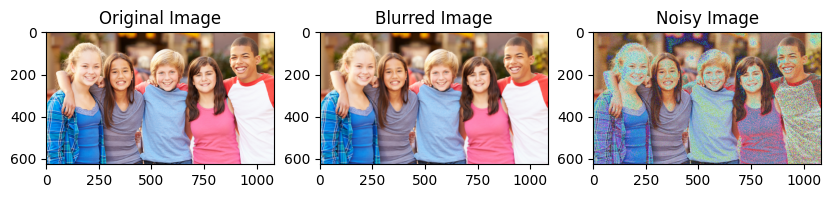

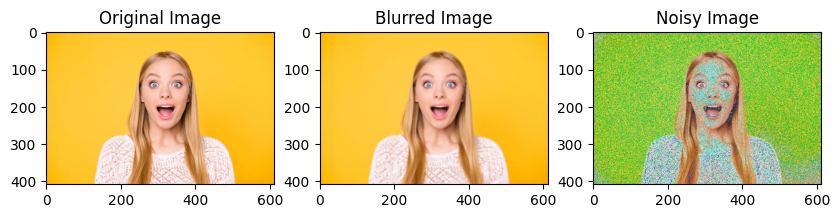

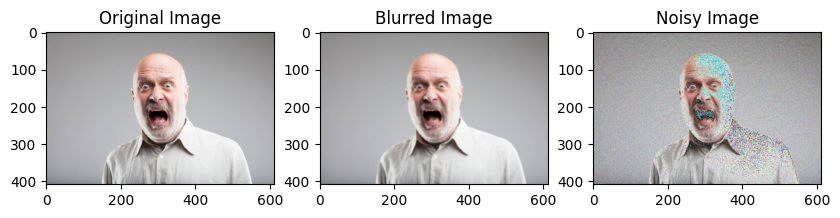

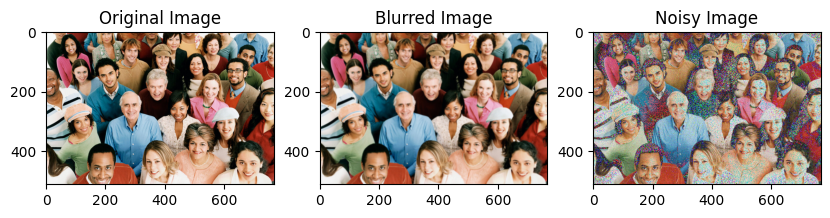

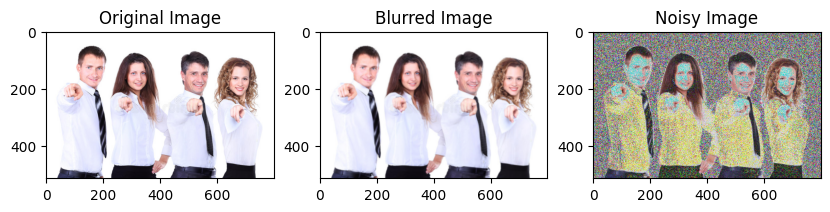

...

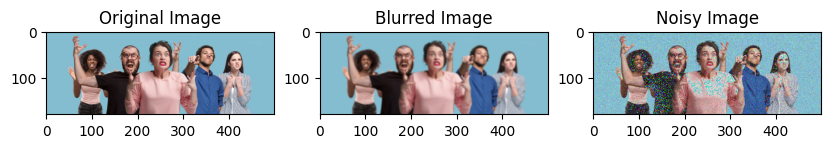

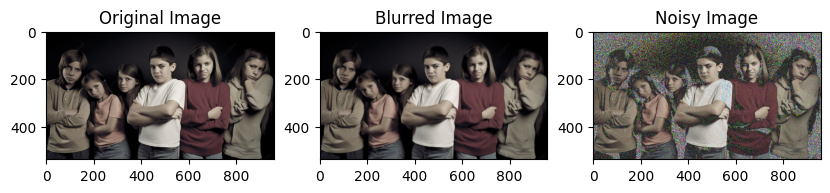

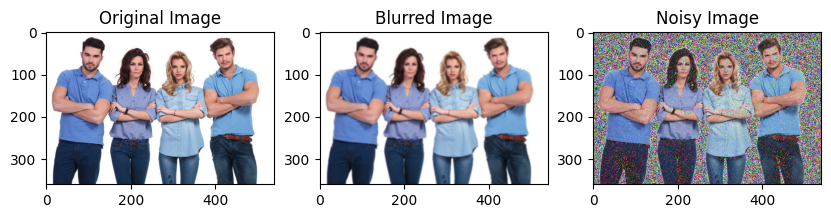

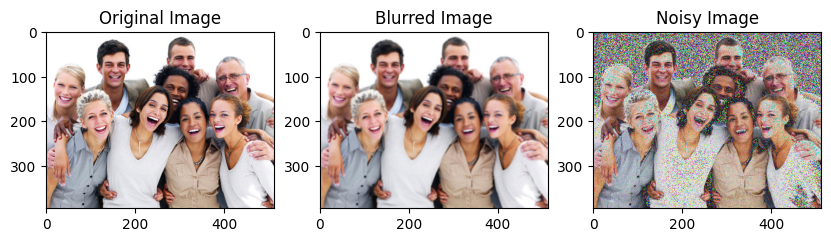

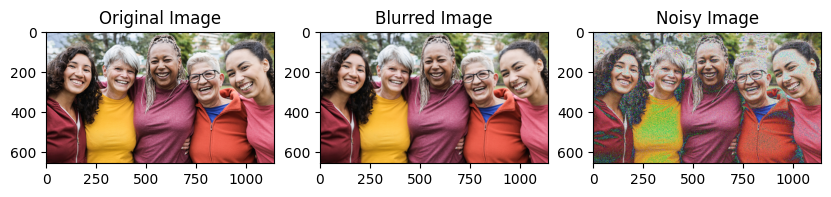

In [48]:
# Specify the path to the folder containing images
dataset_path = 'Images/'

# Create a new folder to save processed images (if needed)
output_path = 'ProcessedImages/'
os.makedirs(output_path, exist_ok=True)

# Loop through each file in the folder
for filename in os.listdir(dataset_path):
    if filename.endswith('.jpg') or filename.endswith('.png') or filename.endswith('.jpeg'):  # Assuming images are JPEG or PNG
        # Read an image
        image_path = os.path.join(dataset_path, filename)
        image = cv2.imread(image_path)

        # Apply Gaussian blur
        kernel_size = 5
        blurred_image = cv2.GaussianBlur(image, (kernel_size, kernel_size), 0)

        # Add Gaussian noise
        mean = 0
        std_dev = 20
        gaussian_noise = np.random.normal(mean, std_dev, image.shape)
        noisy_image = image + gaussian_noise.astype(np.uint8)

        # Save the processed images
        cv2.imwrite(os.path.join(output_path, 'blurred_' + filename), blurred_image)
        cv2.imwrite(os.path.join(output_path, 'noisy_' + filename), noisy_image)

        # Display the original and processed images
        plt.figure(figsize=(10, 4))
        plt.subplot(1, 3, 1)
        plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        plt.title('Original Image')

        plt.subplot(1, 3, 2)
        plt.imshow(cv2.cvtColor(blurred_image, cv2.COLOR_BGR2RGB))
        plt.title('Blurred Image')

        plt.subplot(1, 3, 3)
        plt.imshow(cv2.cvtColor(noisy_image, cv2.COLOR_BGR2RGB))
        plt.title('Noisy Image')

        plt.show()

### Checking Manipulated Images using DeepFace

#### Gaussian Blur Images

Action: race: 100%|██████████| 4/4 [00:00<00:00,  7.30it/s]


Number of faces detected: 1
Number of eyes detected: 2


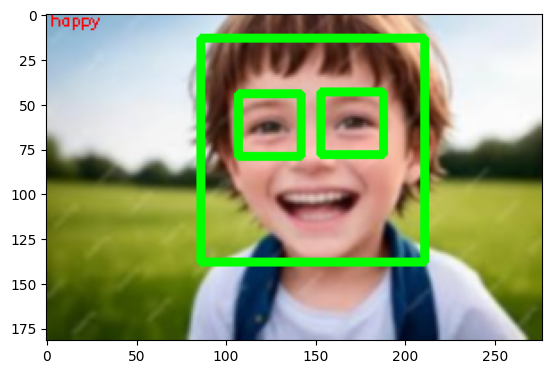

In [49]:
image_brt=cv2.imread("ProcessedImages/blurred_happy_image_2.jpg")
predicted=DeepFace.analyze(image_brt)
annotate(image_brt)
font = cv2.FONT_HERSHEY_SIMPLEX

cv2.putText(image_brt,
            predicted[0]['dominant_emotion'],
            (2,6),
            font, 0.3,
            (0,0,255),
            0,);
plt.imshow(cv2.cvtColor(image_brt, cv2.COLOR_BGR2RGB))

Action: race: 100%|██████████| 4/4 [00:00<00:00,  7.53it/s]


Number of faces detected: 3
Number of eyes detected: 1


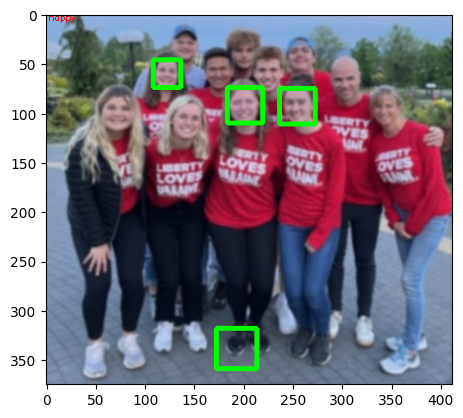

In [50]:
image_blur_1=cv2.imread("ProcessedImages/blurred_ukr_group.jpg")
predicted=DeepFace.analyze(image_blur_1)
annotate(image_blur_1)
font = cv2.FONT_HERSHEY_SIMPLEX

cv2.putText(image_blur_1,
            predicted[0]['dominant_emotion'],
            (2,6),
            font, 0.3,
            (0,0,255),
            0,);
plt.imshow(cv2.cvtColor(image_blur_1, cv2.COLOR_BGR2RGB))

#### Gaussian Noisy Image

Action: race: 100%|██████████| 4/4 [00:00<00:00,  6.08it/s]

Number of faces detected: 1
Number of eyes detected: 0


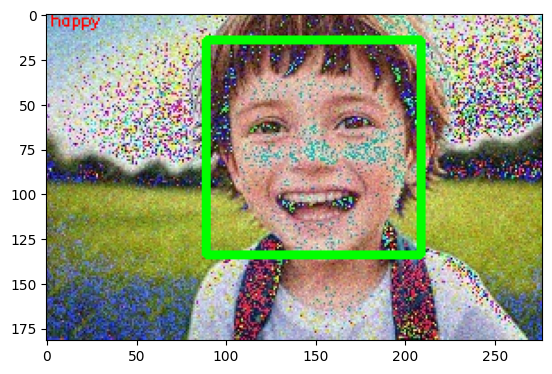

In [51]:
image_noisy=cv2.imread("ProcessedImages/noisy_happy_image_2.jpg")
predicted=DeepFace.analyze(image_noisy)
annotate(image_noisy)
font = cv2.FONT_HERSHEY_SIMPLEX

cv2.putText(image_noisy,
            predicted[0]['dominant_emotion'],
            (2,6),
            font, 0.3,
            (0,0,255),
            0,);
plt.imshow(cv2.cvtColor(image_noisy, cv2.COLOR_BGR2RGB))

Action: race: 100%|██████████| 4/4 [00:00<00:00,  6.87it/s]


Number of faces detected: 1
Number of eyes detected: 0


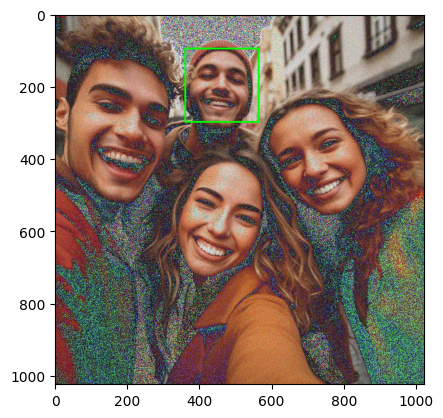

In [52]:
image_noisy_1=cv2.imread("ProcessedImages/noisy_happy_group_1.jpg")
predicted=DeepFace.analyze(image_noisy_1)
annotate(image_noisy_1)
font = cv2.FONT_HERSHEY_SIMPLEX

cv2.putText(image_noisy_1,
            predicted[0]['dominant_emotion'],
            (2,6),
            font, 0.3,
            (0,0,255),
            0,);
plt.imshow(cv2.cvtColor(image_noisy_1, cv2.COLOR_BGR2RGB))

### Checking all the Manipulated Images with CNN

1/1 [==============================] - 0s 26ms/step


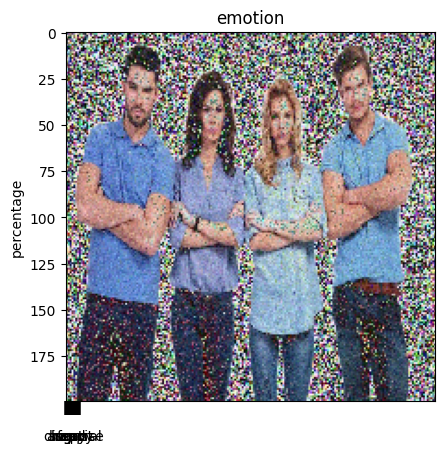

Expression Prediction: angry


In [60]:
_img_ = load_img('ProcessedImages/noisy_angry_image_2.jpg', grayscale=True, target_size=(48, 48))
show_img=load_img('ProcessedImages/noisy_angry_image_2.jpg', grayscale=False, target_size=(200, 200))
m = img_to_array(_img_)
m = np.expand_dims(m, axis = 0)

m /= 255

custom = mdl.predict(m)
#print(custom[0])
analyze_emotion(custom[0])

m = np.array(m, 'float32')
m = m.reshape([48, 48]);

plt.gray()
plt.imshow(show_img)
plt.show()

decimal=0.0000000000000000000001
a=custom[0]
for i in range(0,len(a)):
    if a[i]>decimal:
        decimal=a[i]
        ind=i

print('Expression Prediction:',objct[ind])

1/1 [==============================] - 0s 18ms/step


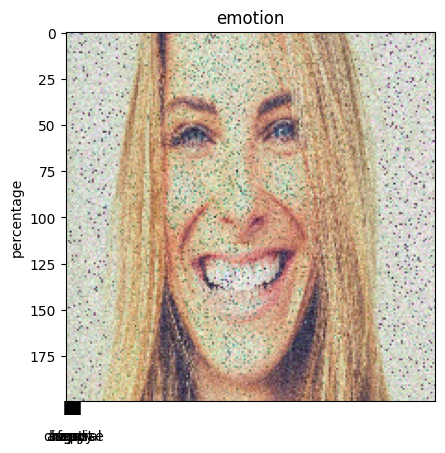

Expression Prediction: happy


In [54]:
_img_ = load_img('ProcessedImages/noisy_happy_4.jpg', grayscale=True, target_size=(48, 48))
show_img=load_img('ProcessedImages/noisy_happy_4.jpg', grayscale=False, target_size=(200, 200))
m = img_to_array(_img_)
m = np.expand_dims(m, axis = 0)

m /= 255

custom = mdl.predict(m)
#print(custom[0])
analyze_emotion(custom[0])

m = np.array(m, 'float32')
m = m.reshape([48, 48]);

plt.gray()
plt.imshow(show_img)
plt.show()

decimal=0.0000000000000000001
a=custom[0]
for i in range(0,len(a)):
    if a[i]>decimal:
        decimal=a[i]
        ind=i

print('Expression Prediction:',objct[ind])

1/1 [==============================] - 0s 21ms/step


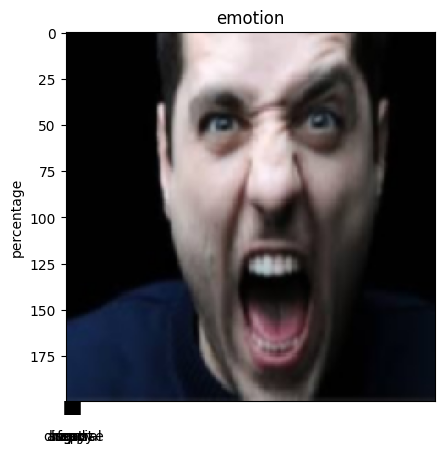

Expression Prediction: angry


In [55]:
_img_ = load_img('ProcessedImages/blurred_angry_2.jpeg', grayscale=True, target_size=(48, 48))
show_img=load_img('ProcessedImages/blurred_angry_2.jpeg', grayscale=False, target_size=(200, 200))
m = img_to_array(_img_)
m = np.expand_dims(m, axis = 0)

m /= 255

custom = mdl.predict(m)
#print(custom[0])
analyze_emotion(custom[0])

m = np.array(m, 'float32')
m = m.reshape([48, 48]);

plt.gray()
plt.imshow(show_img)
plt.show()

decimal=0.00000000000000001
a=custom[0]
for i in range(0,len(a)):
    if a[i]>decimal:
        decimal=a[i]
        ind=i

print('Expression Prediction:',objct[ind])